# Overlay/Spatial Operations & the US Drought Monitor

- Overlay Operations
- Spatial Joins
- Points in Polygons, etc.

We will use data from **US Drought Monitor**:

- https://droughtmonitor.unl.edu/

We'll use data for July 5, 2022: Drought was more widespread than at the time of this writing (circa July 4, 2023), so it makes for a little more interesting workflow...

In [2]:
#First get our basic libraries:

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd

## First get State/County Geometries

- Download from Census
- Restrict to CONUS
- Convert to Alber Equal Area Projection, EPSG 5070

In [3]:
#Get shapefile data directly from census URLs
#########

#Load state & county geometries:
#URLs:
url_state = 'https://www2.census.gov/geo/tiger/GENZ2021/shp/cb_2021_us_state_500k.zip'
url_county = 'https://www2.census.gov/geo/tiger/GENZ2021/shp/cb_2021_us_county_500k.zip'

#And grab:
state_gdf = gpd.read_file(url_state)
county_gdf = gpd.read_file(url_county)

#Also, exclude anything outside the CONUS:
exclude_list = [15, 72, 2, 60, 66, 69, 78]

#~ is not
state_gdf = state_gdf.loc[~state_gdf['STATEFP'].astype(int).isin(exclude_list)]
county_gdf = county_gdf.loc[~county_gdf['STATEFP'].astype(int).isin(exclude_list)]

#Add a FIPS code for the counties:
county_gdf['FIPS'] = county_gdf['STATEFP'] + county_gdf['COUNTYFP']

<AxesSubplot: >

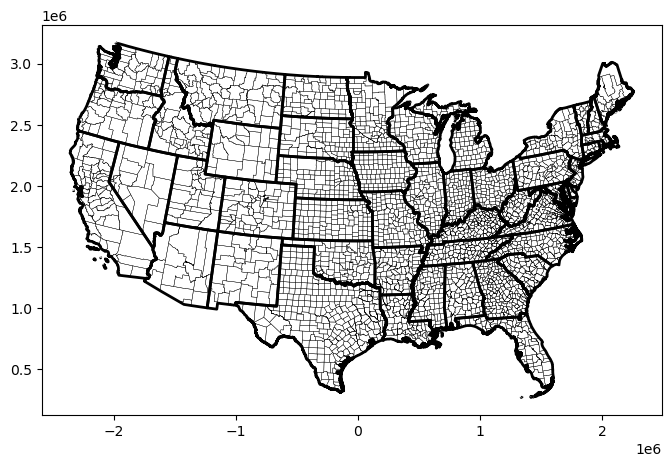

In [4]:
## And convert to North American Albers: EPSG 5070
state_gdf = state_gdf.to_crs(5070)
county_gdf = county_gdf.to_crs(5070)

## Quick set of plots to check result:
fig, ax1 = plt.subplots(1,1, figsize=(8, 8))

state_gdf.plot(ax=ax1, facecolor='none', linewidth=2)
county_gdf.plot(ax=ax1, facecolor='none', linewidth=.25)

## Now for the Drought Shapefiles

In [6]:
#Note that there is non-spatial county data:
url_name = r'https://droughtmonitor.unl.edu/DmData/GISData.aspx?mode=table&aoi=county&date=2022-07-05'

county_drought_df = pd.read_csv(url_name)

county_drought_df.head()

,MapDate,FIPS,County,State,Nothing,D0,D1,D2,D3,D4,ValidStart,ValidEnd
0,20220705,1001,Autauga County,AL,16.36,83.64,0.0,0.0,0.0,0.0,2022-07-05,2022-07-11
1,20220705,1003,Baldwin County,AL,100.00,0.00,0.0,0.0,0.0,0.0,2022-07-05,2022-07-11
2,20220705,1005,Barbour County,AL,100.00,0.00,0.0,0.0,0.0,0.0,2022-07-05,2022-07-11
3,20220705,1007,Bibb County,AL,77.79,22.21,0.0,0.0,0.0,0.0,2022-07-05,2022-07-11
4,20220705,1009,Blount County,AL,100.00,0.00,0.0,0.0,0.0,0.0,2022-07-05,2022-07-11


In [9]:
### But we will just deal with the shapefiles:
### Download GIS Data:

url_name = r'https://droughtmonitor.unl.edu/data/shapefiles_m/USDM_20220705_M.zip'

drought_gdf = gpd.read_file(url_name)


In [10]:
#What did we get?
drought_gdf

,OBJECTID,DM,Shape_Leng,Shape_Area,geometry
0,1,0,8.679166e+07,2.030164e+12,"MULTIPOLYGON (((-67.17698 18.00918, -67.17753 ..."
1,2,1,6.957710e+07,1.559804e+12,"MULTIPOLYGON (((-66.61747 17.96383, -66.61745 ..."
2,3,2,4.895095e+07,1.196336e+12,"MULTIPOLYGON (((-66.60739 18.05543, -66.64189 ..."
3,4,3,3.197661e+07,1.073981e+12,"MULTIPOLYGON (((-97.05445 27.87253, -97.05511 ..."
4,5,4,1.061415e+07,3.002019e+11,"MULTIPOLYGON (((-104.21329 31.16098, -104.1678..."


<AxesSubplot: >

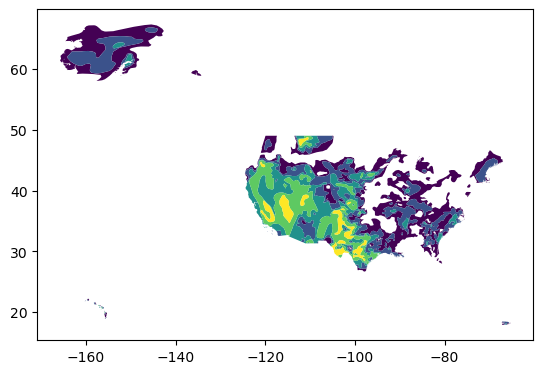

In [11]:
#And a real quick plot:
drought_gdf.plot(column='DM')

### Use `overlay` to restrict to CONUS

- Here we introduce the overlay operation: We'll start with an intersection between a polygon and the shapes above

<AxesSubplot: >

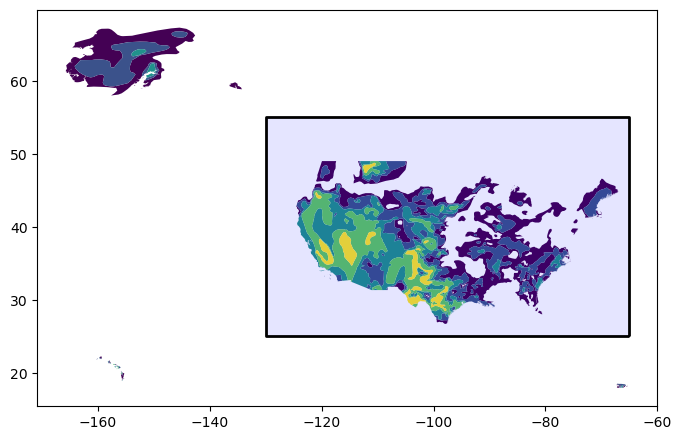

In [22]:
#Let's cut out everything outside the CONUS:
############

#Make a box for CONUS:
from shapely.geometry import box

min_y, max_y = 25, 55
min_x, max_x = -130, -65

#Box for the CONUS: Start as polygon
conus_box = box(minx=min_x, miny=min_y, maxx=max_x, maxy=max_y)

#Turn into a GeoDataFrame:
box_gdf = gpd.GeoDataFrame(index=[0], geometry=[conus_box], crs=drought_gdf.crs)

#Plot it and drought shapefiles both:

fig1, ax1 = plt.subplots(1,1, figsize=(8, 8))

#Plot the drought:
drought_gdf.plot(ax=ax1, column='DM')

#And our box:
box_gdf.plot(ax=ax1, facecolor='blue', alpha=.1,)
box_gdf.plot(ax=ax1, facecolor='none', edgecolor='black', linewidth=2)


In [23]:
#And do the overlay:
######

drought_gdf = gpd.overlay(drought_gdf, box_gdf, how="intersection")

In [24]:
#Now what do we have?
drought_gdf

,OBJECTID,DM,Shape_Leng,Shape_Area,geometry
0,1,0,8.679166e+07,2.030164e+12,"MULTIPOLYGON (((-69.15743 46.08797, -68.82271 ..."
1,2,1,6.957710e+07,1.559804e+12,"MULTIPOLYGON (((-68.15419 44.50111, -68.16052 ..."
2,3,2,4.895095e+07,1.196336e+12,"MULTIPOLYGON (((-77.33577 34.76774, -77.18715 ..."
3,4,3,3.197661e+07,1.073981e+12,"MULTIPOLYGON (((-94.53966 29.56260, -94.54048 ..."
4,5,4,1.061415e+07,3.002019e+11,"MULTIPOLYGON (((-97.77271 31.02361, -97.88423 ..."


<AxesSubplot: >

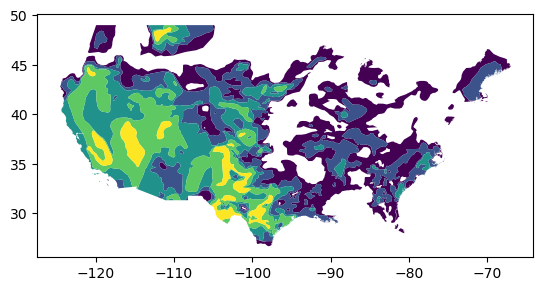

In [25]:
#Graphically?
drought_gdf.plot(column='DM')

<AxesSubplot: >

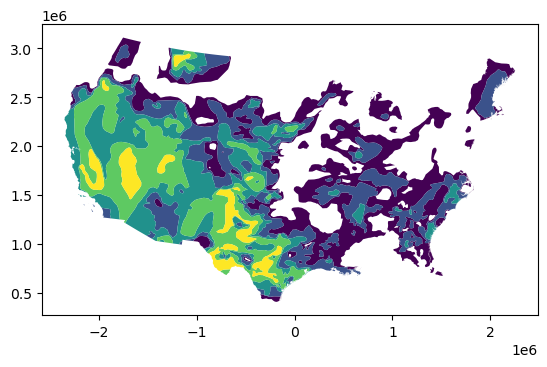

In [26]:
#Also, convert to CRS 5070
#####

drought_gdf = drought_gdf.to_crs(5070)

drought_gdf.plot(column='DM')

### Some Improved Plots!

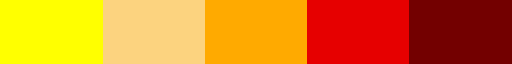

In [27]:
#Let's use a custom colormap as well, for plotting below:
from matplotlib.colors import ListedColormap

vals = [[255/255, 255/255, 0/255],
        [252/255, 211/255, 127/255],
        [255/255, 170/255, 0/255],
        [230/255, 0/255, 0/255],
        [115/255, 0/255, 0/255]]

drought_cmap = ListedColormap(vals)

drought_cmap

In [29]:
#And also map DM column to a description:
desc_dict = {0: 'D0 (Abnormally Dry)', 1: 'D1 (Moderate Drought)', 2: 'D2 (Severe Drought)',
             3: 'D3 (Extreme Drought)', 4: 'D4 (Exceptional Drought)'}

drought_gdf['DM_String'] = [desc_dict[i] for i in drought_gdf['DM'].values]

#Yields:
drought_gdf

,OBJECTID,DM,Shape_Leng,Shape_Area,geometry,DM_String
0,1,0,8.679166e+07,2.030164e+12,"MULTIPOLYGON (((2051978.405 2858361.179, 20806...",D0 (Abnormally Dry)
1,2,1,6.957710e+07,1.559804e+12,"MULTIPOLYGON (((2177470.618 2711487.085, 21768...",D1 (Moderate Drought)
2,3,2,4.895095e+07,1.196336e+12,"MULTIPOLYGON (((1683663.026 1466684.855, 16983...",D2 (Severe Drought)
3,4,3,3.197661e+07,1.073981e+12,"MULTIPOLYGON (((141491.780 721947.138, 141411....",D3 (Extreme Drought)
4,5,4,1.061415e+07,3.002019e+11,"MULTIPOLYGON (((-168727.077 884665.745, -17940...",D4 (Exceptional Drought)


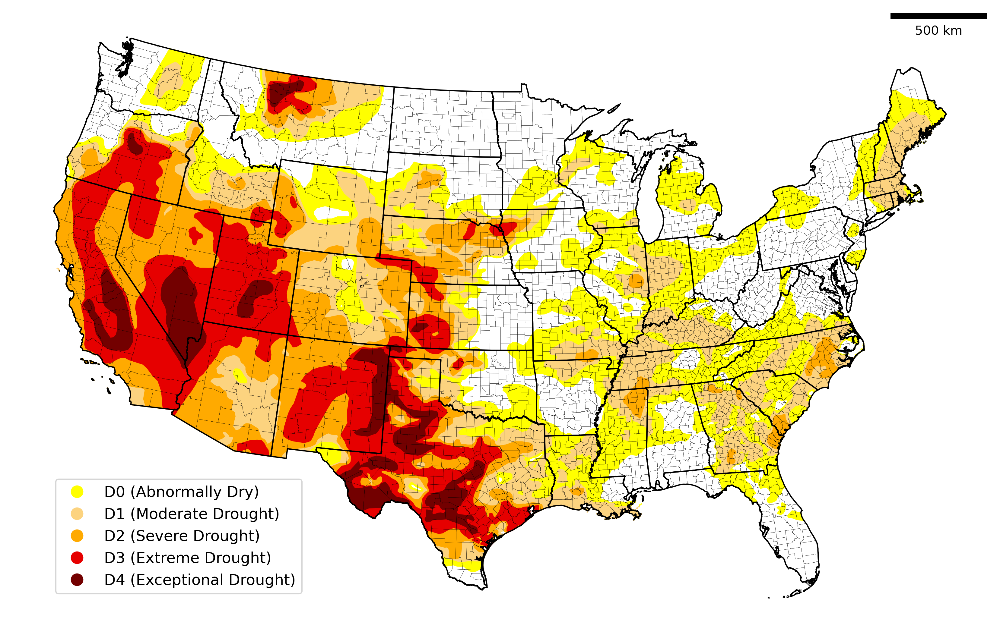

In [31]:
#Plot with states/counties:
###########

fig1, ax1 = plt.subplots(1,1, figsize=(14, 10), dpi=300)

drought_gdf.plot(ax=ax1, edgecolor='face', column='DM_String', cmap=drought_cmap,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.04,0.04), 'fontsize':12})

#County outlines
county_gdf.plot(ax=ax1, edgecolor='black', linewidth=.1, facecolor='none')

#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')

#Some aesthetics
ax1.set_axis_off()

#Throw in a scalebar as well
#Need to import this library separately, so feel free to comment out
from matplotlib_scalebar.scalebar import ScaleBar

ax1.add_artist(ScaleBar(1, length_fraction=0.1));

### Some more `overlay` operations

We have several `overlay` set operations:

<img src="https://geopandas.org/en/stable/_images/overlay_operations.png" alt="drawing" style="width:625px;"/>

- Let's do these operations with our Moderate Drought polygon and Arizona

In [41]:
az_gdf = state_gdf.loc[state_gdf.STATEFP == '04']

#Also get the counties:
az_counties = county_gdf.loc[county_gdf.STATEFP == '04']

#And the drought shapes
d1_gdf = drought_gdf.loc[drought_gdf.DM == 1]

<AxesSubplot: >

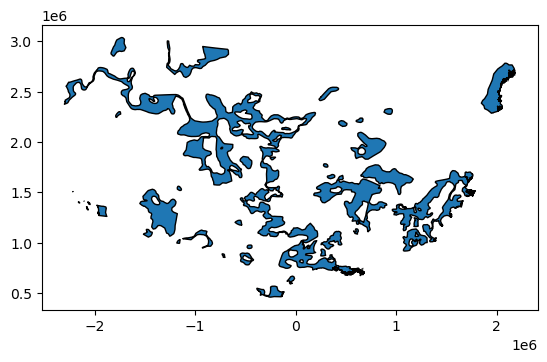

In [91]:
d1_gdf.plot(edgecolor='black')

In [34]:
#Do Intersection
##########

overlay_gdf = gpd.overlay(az_gdf, d1_gdf, how="intersection")


In [35]:
#Do Union
##########

overlay_gdf = gpd.overlay(az_gdf, d1_gdf, how="union")

In [36]:
#Do Symmetrical Difference
##########

overlay_gdf = gpd.overlay(az_gdf, d1_gdf, how="symmetric_difference")

In [37]:
#Do Difference
##########

overlay_gdf = gpd.overlay(az_gdf, d1_gdf, how="difference")

<AxesSubplot: >

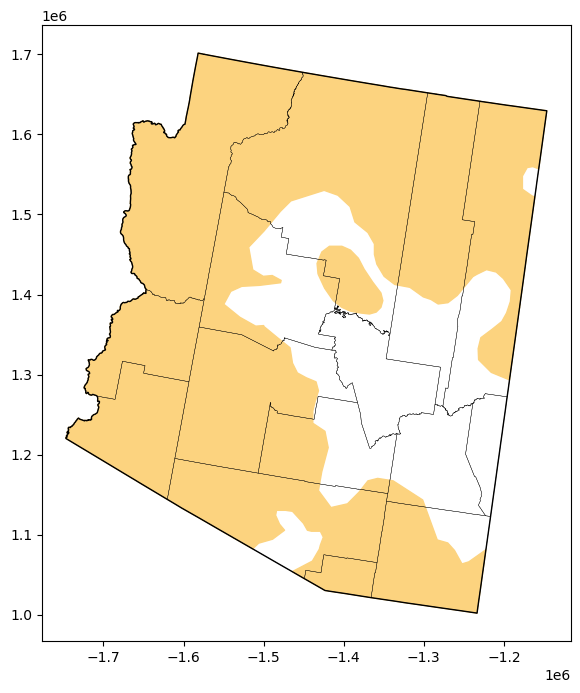

In [38]:
## And plot:
############

fig1, ax1 = plt.subplots(1,1, figsize=(10, 8))

overlay_gdf.plot(ax=ax1, edgecolor='face', color=drought_cmap(1),
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.04,0.04), 'fontsize':12})

#County outlines
az_counties.plot(ax=ax1, edgecolor='black', linewidth=.25, facecolor='none')

#State outlines:
az_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')



### How Much of AZ is in D0 or D1 drought levels?

- Can easily answer using `overlay` and the `area` attribute...
- But note some subtleties with Series... 

In [43]:
#Start with just d1_gdf from before:
overlay_gdf = gpd.overlay(az_gdf, d1_gdf, how="intersection")

In [44]:
#Note the areas:
#This is a Series object

az_gdf.area

39    2.952328e+11
dtype: float64

In [45]:
type(az_gdf.area)

pandas.core.series.Series

In [46]:
#Similar for overlay_gdf
#But index will not match above
overlay_gdf.area

0    8.471243e+10
dtype: float64

In [49]:
#This will not give us what we want:
overlay_gdf.area / az_gdf.area

0    NaN
39   NaN
dtype: float64

In [50]:
#This will:
overlay_gdf.area.values / az_gdf.area.values

array([0.28693432])

In [51]:
#Get Intersections for both DM0 and DM1
##########

#DM0
overlay_gdf = gpd.overlay(az_gdf, drought_gdf.loc[drought_gdf.DM == 0], how="intersection")

#Use values, since index doesn't match up:
print(overlay_gdf.area.values / az_gdf.area.values)


#DM1
overlay_gdf = gpd.overlay(az_gdf, drought_gdf.loc[drought_gdf.DM == 1], how="intersection")

#Use values, since index doesn't match up:
print(overlay_gdf.area.values / az_gdf.area.values)

[0.01521557]
[0.28693432]


## Spatial Join: Drought Status of Each County Based on Centroid

- GeoPandas `sjoin`

`how` options:

- left

- right

- inner


`predicate` (or `op`) options:

- intersects

- contains

- within

- touches

- crosses

- overlaps


#### Also have `sjoin_nearest` function


<AxesSubplot: >

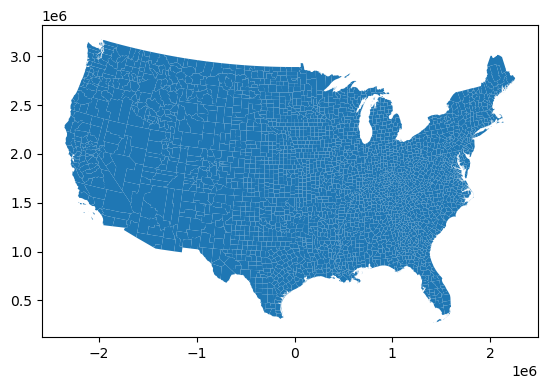

In [52]:
#Recall our county geometry:
county_gdf.plot()

In [53]:
#Let's get our centroids:
county_gdf['cent'] = county_gdf.centroid

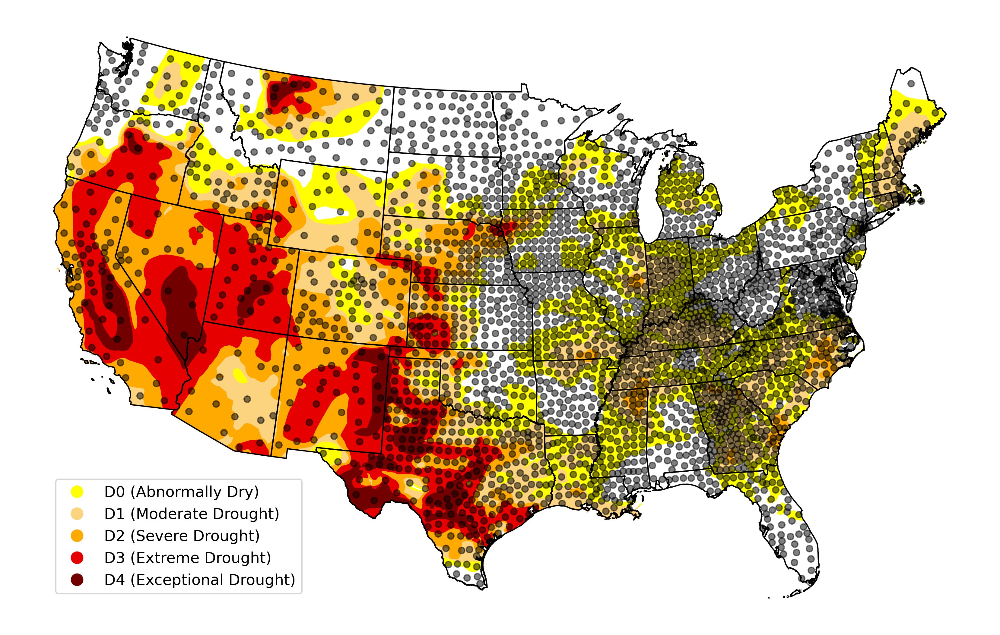

In [57]:
#Now, let's plot the drought levels along with the centroids:
fig1, ax1 = plt.subplots(1,1, figsize=(14, 10), dpi=300)

drought_gdf.plot(ax=ax1, edgecolor='face', column='DM_String', cmap=drought_cmap,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.04,0.04), 'fontsize':12})

#County centroids:
county_gdf = county_gdf.set_geometry('cent')

county_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='black', alpha=.5, markersize=25)

#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')

#Some aesthetics
ax1.set_axis_off()


In [58]:
#Set to centroid geometry, and do a spatial join:
county_gdf = county_gdf.set_geometry('cent')

# Make a spatial join
# Determine what drought level each county is in, based on the centroid
join_gdf1 = gpd.sjoin(county_gdf, drought_gdf, how="left", predicate="within")


In [59]:
#We got?
join_gdf1

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,STATE_NAME,LSAD,...,AWATER,geometry,FIPS,cent,index_right,OBJECTID,DM,Shape_Leng,Shape_Area,DM_String
0,20,161,00485044,0500000US20161,20161,Riley,Riley County,KS,Kansas,06,...,32047392,"POLYGON ((-82124.738 1807458.230, -82132.336 1...",20161,POINT (-62791.693 1808364.729),NaN,NaN,NaN,NaN,NaN,NaN
1,19,159,00465268,0500000US19159,19159,Ringgold,Ringgold County,IA,Iowa,06,...,8723135,"POLYGON ((127862.311 1979027.467, 127850.008 1...",19159,POINT (147068.634 1970685.255),NaN,NaN,NaN,NaN,NaN,NaN
2,30,009,01720111,0500000US30009,30009,Carbon,Carbon County,MT,Montana,06,...,35213028,"POLYGON ((-1080043.778 2542886.554, -1071425.2...",30009,POINT (-1019186.416 2540997.085),NaN,NaN,NaN,NaN,NaN,NaN
3,16,007,00395090,0500000US16007,16007,Bear Lake,Bear Lake County,ID,Idaho,06,...,191364281,"POLYGON ((-1269953.954 2279390.018, -1269561.5...",16007,POINT (-1250532.947 2243806.709),3.0,4.0,3.0,3.197661e+07,1.073981e+12,D3 (Extreme Drought)
4,55,011,01581065,0500000US55011,55011,Buffalo,Buffalo County,WI,Wisconsin,06,...,87549529,"POLYGON ((310980.660 2386653.979, 311029.751 2...",55011,POINT (337296.547 2384166.843),NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3229,53,003,01533502,0500000US53003,53003,Asotin,Asotin County,WA,Washington,06,...,11291731,"POLYGON ((-1649096.511 2757565.423, -1644531.2...",53003,POINT (-1626480.276 2760322.205),NaN,NaN,NaN,NaN,NaN,NaN
3230,13,043,00342852,0500000US13043,13043,Candler,Candler County,GA,Georgia,06,...,15018189,"POLYGON ((1282504.903 1123868.469, 1282643.946...",13043,POINT (1298419.237 1132053.817),1.0,2.0,1.0,6.957710e+07,1.559804e+12,D1 (Moderate Drought)
3231,48,451,01384011,0500000US48451,48451,Tom Green,Tom Green County,TX,Texas,06,...,48077315,"POLYGON ((-497863.947 956184.834, -496234.612 ...",48451,POINT (-422562.561 935371.154),3.0,4.0,3.0,3.197661e+07,1.073981e+12,D3 (Extreme Drought)
3232,39,089,01074057,0500000US39089,39089,Licking,Licking County,OH,Ohio,06,...,12761090,"POLYGON ((1115778.594 1958759.194, 1115689.498...",39089,POINT (1138530.043 1978344.556),NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
#Our columns:
join_gdf1.columns

Index(['STATEFP', 'COUNTYFP', 'COUNTYNS', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'STATE_NAME', 'LSAD', 'ALAND', 'AWATER',
       'geometry', 'FIPS', 'cent', 'index_right', 'OBJECTID', 'DM',
       'Shape_Leng', 'Shape_Area', 'DM_String'],
      dtype='object')

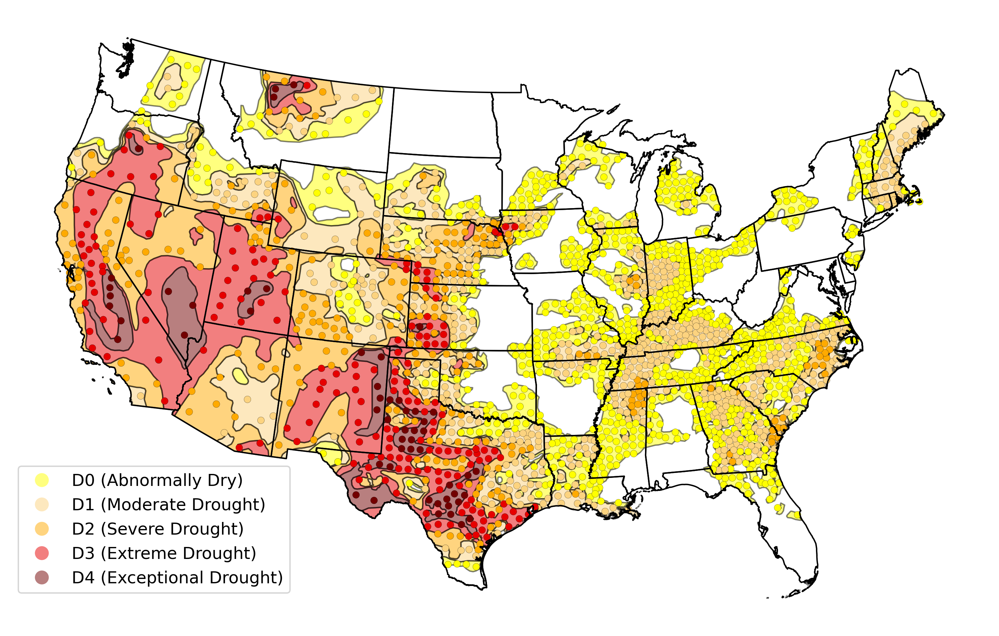

In [67]:
#Now Plot the result
########

#join_gdf1 = join_gdf1.set_geometry('geometry')

fig1, ax1 = plt.subplots(1,1, figsize=(16, 8), dpi=300)

drought_gdf.plot(ax=ax1, edgecolor='black', column='DM_String', cmap=drought_cmap, alpha=.5,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.0,0.04), 'fontsize':12})


join_gdf1.plot(ax=ax1, edgecolor='black', linewidth=.1, column='DM', cmap=drought_cmap, alpha=1, markersize=25)

#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')

ax1.set_axis_off()

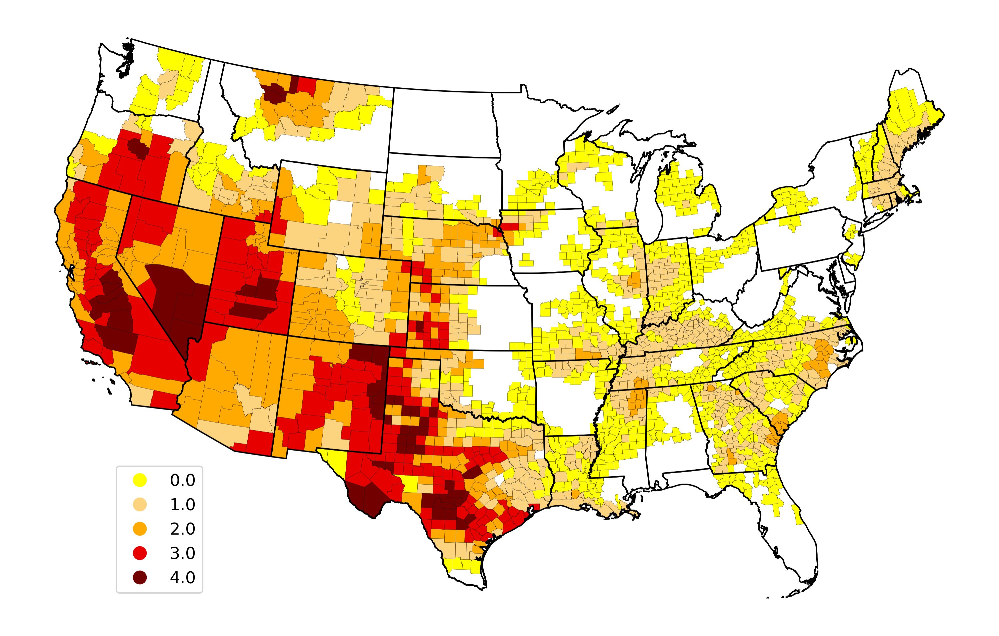

In [73]:
#And plot the geometries of join_gdf1:

join_gdf1 = join_gdf1.set_geometry('geometry')

fig1, ax1 = plt.subplots(1,1, figsize=(16, 8), dpi=300)

join_gdf1.plot(ax=ax1, edgecolor='black', linewidth=.1, column='DM', cmap=drought_cmap, alpha=1,
              categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.1,0.04), 'fontsize':12})

#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')

ax1.set_axis_off()

#### What if we use the polygon instead of the centroid?

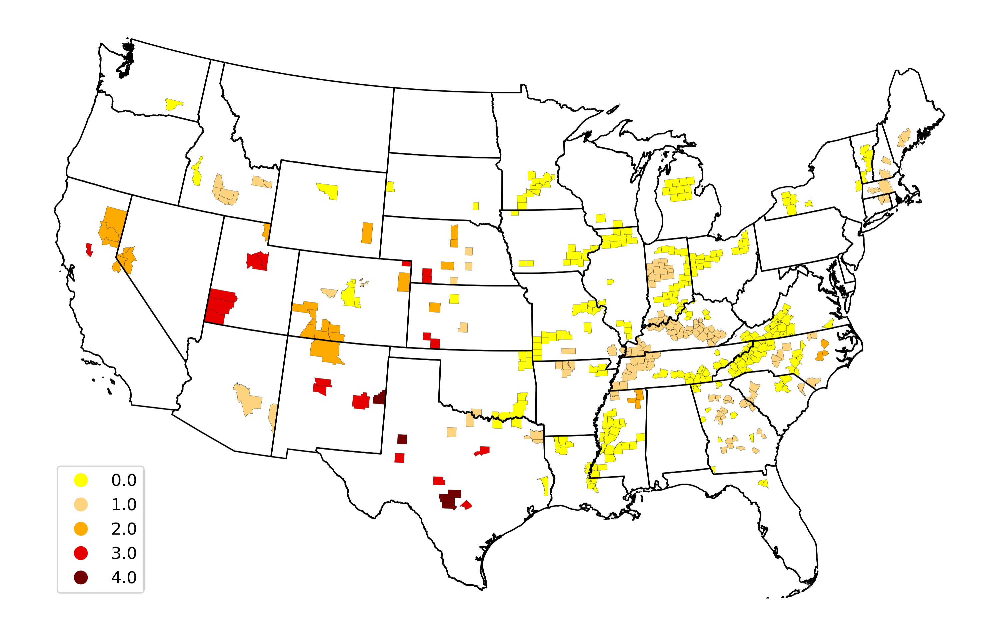

In [74]:
#Can also try with the polygonal geometries:
###########

county_gdf = county_gdf.set_geometry('geometry')

# Spatial join within?
join_gdf2 = gpd.sjoin(county_gdf, drought_gdf, how="left", predicate="within")


#Plot:
fig1, ax1 = plt.subplots(1,1, figsize=(16, 8), dpi=300)
join_gdf2.plot(ax=ax1, edgecolor='black', linewidth=.1, column='DM', cmap=drought_cmap, alpha=1,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.04,0.04), 'fontsize':12})
#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')
ax1.set_axis_off()


,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,STATE_NAME,LSAD,...,AWATER,geometry,FIPS,cent,index_right,OBJECTID,DM,Shape_Leng,Shape_Area,DM_String
0,20,161,00485044,0500000US20161,20161,Riley,Riley County,KS,Kansas,06,...,32047392,"POLYGON ((-82124.738 1807458.230, -82132.336 1...",20161,POINT (-62791.693 1808364.729),NaN,NaN,NaN,NaN,NaN,NaN
1,19,159,00465268,0500000US19159,19159,Ringgold,Ringgold County,IA,Iowa,06,...,8723135,"POLYGON ((127862.311 1979027.467, 127850.008 1...",19159,POINT (147068.634 1970685.255),0.0,1.0,0.0,8.679166e+07,2.030164e+12,D0 (Abnormally Dry)
2,30,009,01720111,0500000US30009,30009,Carbon,Carbon County,MT,Montana,06,...,35213028,"POLYGON ((-1080043.778 2542886.554, -1071425.2...",30009,POINT (-1019186.416 2540997.085),0.0,1.0,0.0,8.679166e+07,2.030164e+12,D0 (Abnormally Dry)
3,16,007,00395090,0500000US16007,16007,Bear Lake,Bear Lake County,ID,Idaho,06,...,191364281,"POLYGON ((-1269953.954 2279390.018, -1269561.5...",16007,POINT (-1250532.947 2243806.709),2.0,3.0,2.0,4.895095e+07,1.196336e+12,D2 (Severe Drought)
3,16,007,00395090,0500000US16007,16007,Bear Lake,Bear Lake County,ID,Idaho,06,...,191364281,"POLYGON ((-1269953.954 2279390.018, -1269561.5...",16007,POINT (-1250532.947 2243806.709),3.0,4.0,3.0,3.197661e+07,1.073981e+12,D3 (Extreme Drought)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3231,48,451,01384011,0500000US48451,48451,Tom Green,Tom Green County,TX,Texas,06,...,48077315,"POLYGON ((-497863.947 956184.834, -496234.612 ...",48451,POINT (-422562.561 935371.154),3.0,4.0,3.0,3.197661e+07,1.073981e+12,D3 (Extreme Drought)
3232,39,089,01074057,0500000US39089,39089,Licking,Licking County,OH,Ohio,06,...,12761090,"POLYGON ((1115778.594 1958759.194, 1115689.498...",39089,POINT (1138530.043 1978344.556),NaN,NaN,NaN,NaN,NaN,NaN
3233,19,193,00465285,0500000US19193,19193,Woodbury,Woodbury County,IA,Iowa,06,...,12793700,"POLYGON ((-40702.990 2173757.032, -37607.588 2...",19193,POINT (-3654.508 2154497.123),2.0,3.0,2.0,4.895095e+07,1.196336e+12,D2 (Severe Drought)
3233,19,193,00465285,0500000US19193,19193,Woodbury,Woodbury County,IA,Iowa,06,...,12793700,"POLYGON ((-40702.990 2173757.032, -37607.588 2...",19193,POINT (-3654.508 2154497.123),1.0,2.0,1.0,6.957710e+07,1.559804e+12,D1 (Moderate Drought)


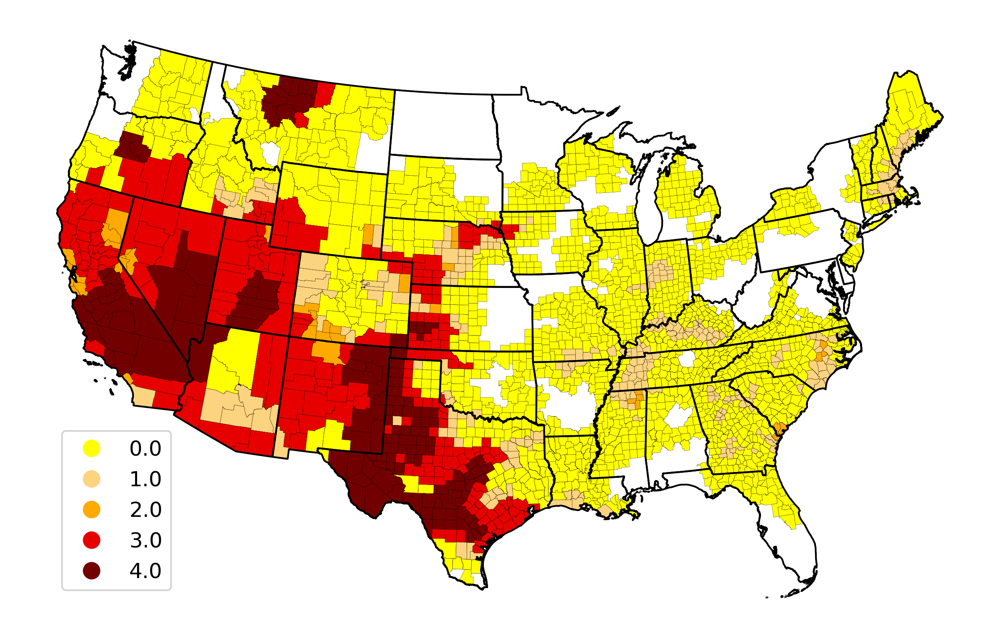

In [75]:
# Spatial join intersects?
####

join_gdf2 = gpd.sjoin(county_gdf, drought_gdf, how="left", predicate="intersects")


#Plot:
fig1, ax1 = plt.subplots(1,1, figsize=(10, 8), dpi=300)
join_gdf2.plot(ax=ax1, edgecolor='black', linewidth=.1, column='DM', cmap=drought_cmap, alpha=1,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.04,0.04), 'fontsize':12})

#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')
ax1.set_axis_off()


#And the problem? Intersected multiple drought levels, gives us duplicate rows
join_gdf2

#### `sjoin_nearest`:

- Need `pygeos` library. Also, be sure to set the geometry for counties to the centroid, or you'll be waiting all night

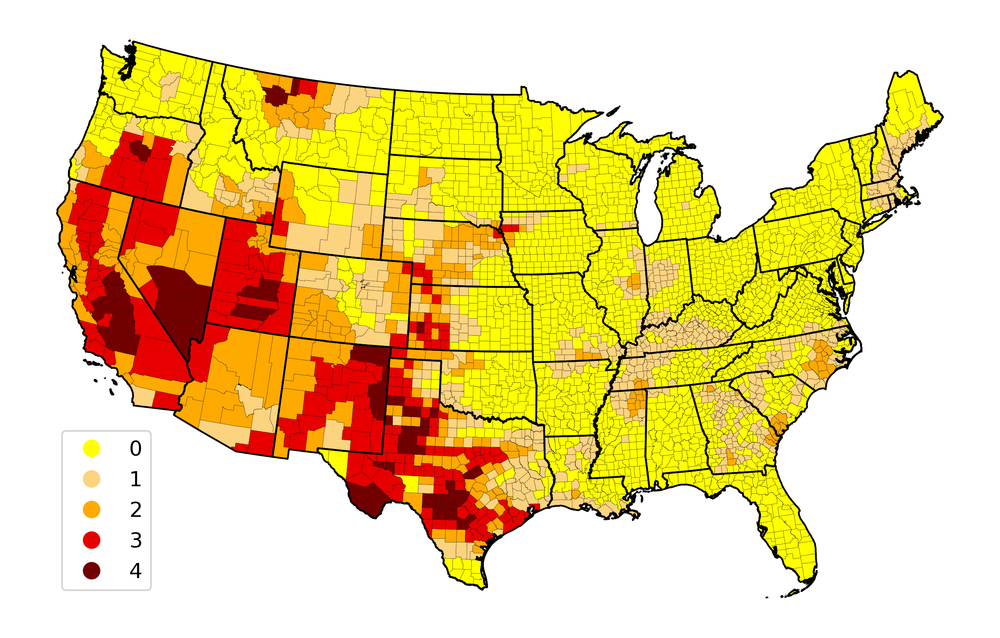

In [76]:
# Try a sjoin_nearest
# Need to install pygeos for this: conda install pygeos
county_gdf = county_gdf.set_geometry('cent')

join_gdf2 = gpd.sjoin_nearest(county_gdf, drought_gdf, how="left")



#Plot:
join_gdf2 = join_gdf2.set_geometry('geometry')

fig1, ax1 = plt.subplots(1,1, figsize=(10, 8), dpi=300)
join_gdf2.plot(ax=ax1, edgecolor='black', linewidth=.1, column='DM', cmap=drought_cmap, alpha=1,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.04,0.04), 'fontsize':12})
#State outlines:
state_gdf.plot(ax=ax1, edgecolor='black', linewidth=1, facecolor='none')
ax1.set_axis_off()

### Counties with Multiple Drought Levels: What to do?

- Above we just have the nearest or best guess for drought level, but most counties overlap multiple drought levels. How to represent?

- Could take a weighted average of areas in each drought level

- In fact, let's do this...

In [77]:
#We'll make the following new variables:
var_list = ['AREA' + str(i) for i in range(0, len(drought_gdf))]
var_list


['AREA0', 'AREA1', 'AREA2', 'AREA3', 'AREA4']

In [78]:
#Let's get an intersection with each drought level
####
county_gdf = county_gdf.set_geometry('geometry')

#A new gdf to track results:
drought_level_gdf = county_gdf.copy()

for i in range(0, len(drought_gdf)):
    
    #Intersection:
    overlay_gdf = gpd.overlay(county_gdf, drought_gdf.loc[drought_gdf.DM == i], how="intersection")
    
    #Now, let's determine the area associated with each county
    overlay_gdf['AREA' + str(i)] = overlay_gdf.area
    
    #And merge this area with our tracking gdf:
    drought_level_gdf = drought_level_gdf.merge(overlay_gdf[['AREA' + str(i), 'FIPS']], on='FIPS', how='left').fillna(0)

In [79]:
#Results?
drought_level_gdf[var_list]

,AREA0,AREA1,AREA2,AREA3,AREA4
0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
1,3.267733e+07,0.000000e+00,0.000000e+00,0.000000e+00,0.0
2,7.226039e+07,0.000000e+00,0.000000e+00,0.000000e+00,0.0
3,0.000000e+00,0.000000e+00,6.541919e+08,2.064855e+09,0.0
4,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
...,...,...,...,...,...
3103,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
3104,0.000000e+00,6.444966e+08,0.000000e+00,0.000000e+00,0.0
3105,0.000000e+00,5.653060e+08,1.171609e+09,2.253696e+09,0.0
3106,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0


In [80]:
#We could sum along each axis to get area in any level of drought, for example:
######

drought_level_gdf[var_list].apply(sum, axis=1) / drought_level_gdf.area

0       0.000000
1       0.023407
2       0.013532
3       1.000000
4       0.000000
          ...   
3103    0.000000
3104    1.000000
3105    1.000000
3106    0.000000
3107    1.000000
Length: 3108, dtype: float64

In [81]:
#Now get a weighted average of drought level: "Drought GPA"
#Add 1 so that 0 maps to no drought, not level 0 drought
###

def f(x):
    total = 0
    for i, y in enumerate(x):
        total += (i + 1) * y
    return total

drought_level_gdf[var_list].apply(f, axis=1)

0       0.000000e+00
1       3.267733e+07
2       7.226039e+07
3       1.022200e+10
4       0.000000e+00
            ...     
3103    0.000000e+00
3104    1.288993e+09
3105    1.366022e+10
3106    0.000000e+00
3107    7.719971e+09
Length: 3108, dtype: float64

In [82]:
#Now, let's get the weighted average drought level for each county...
#Use apply to sum across rows:
#And divide by area:
drought_level_gdf['DM_avg'] = drought_level_gdf[var_list].apply(f, axis=1) / drought_level_gdf.area
drought_level_gdf['DM_avg']

0       0.000000
1       0.023407
2       0.013532
3       3.759404
4       0.000000
          ...   
3103    0.000000
3104    2.000000
3105    3.423091
3106    0.000000
3107    3.395930
Name: DM_avg, Length: 3108, dtype: float64

### And plot again:

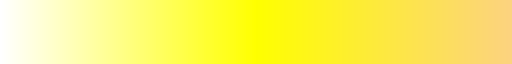

In [83]:
#For Plotting: Let's make our own continuous colormap...
#Example of LinearSegmentedColormap:
#########

from matplotlib.colors import ListedColormap, LinearSegmentedColormap

cdict = {'red':   [[0, 1.0, 1.0],
                   [.5, 255/255, 255/255],
                   [1, 252/255, 252/255]],
         'green': [[0, 1.0, 1.0],
                   [.5, 255/255, 255/255],
                   [1, 211/255, 211/255]],
         'blue':  [[0, 1.0, 1.0],
                   [.5, 0.0, 0],
                   [1, 127/255, 127/255]]}

newcmp = LinearSegmentedColormap('A_beautiful_colormap', segmentdata=cdict, N=256)

newcmp

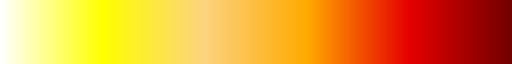

In [84]:
#The complete map:
###########

cdict = {'red':   [[0, 1.0, 1.0],
                   [.2, 255/255, 255/255],
                   [.4, 252/255, 252/255],
                   [.6, 255/255, 255/255],
                   [.8, 230/255, 230/255],
                   [1, 115/255, 115/255]],
         'green': [[0, 1.0, 1.0],
                   [0.2, 255/255, 255/255],
                   [0.4, 211/255, 211/255],
                   [0.6, 170/255, 170/255],
                   [0.8, 0.0, 0.0],
                   [1, 0.0, 0.0]],
         'blue':  [[0, 1.0, 1.0],
                   [0.2, 0.0, 0.0],
                   [.4, 127/255, 127/255],
                   [0.6, 0.0, 0.0],
                   [0.8, 0.0, 0.0],
                   [1, 0.0, 0.0]]}

#These are our underlying values:
#vals = [[255/255, 255/255, 0/255],
#        [252/255, 211/255, 127/255],
#        [255/255, 170/255, 0/255],
#        [230/255, 0/255, 0/255],
#        [115/255, 0/255, 0/255]]


drought_linear_cmap = LinearSegmentedColormap('drought_map', segmentdata=cdict, N=256)

drought_linear_cmap

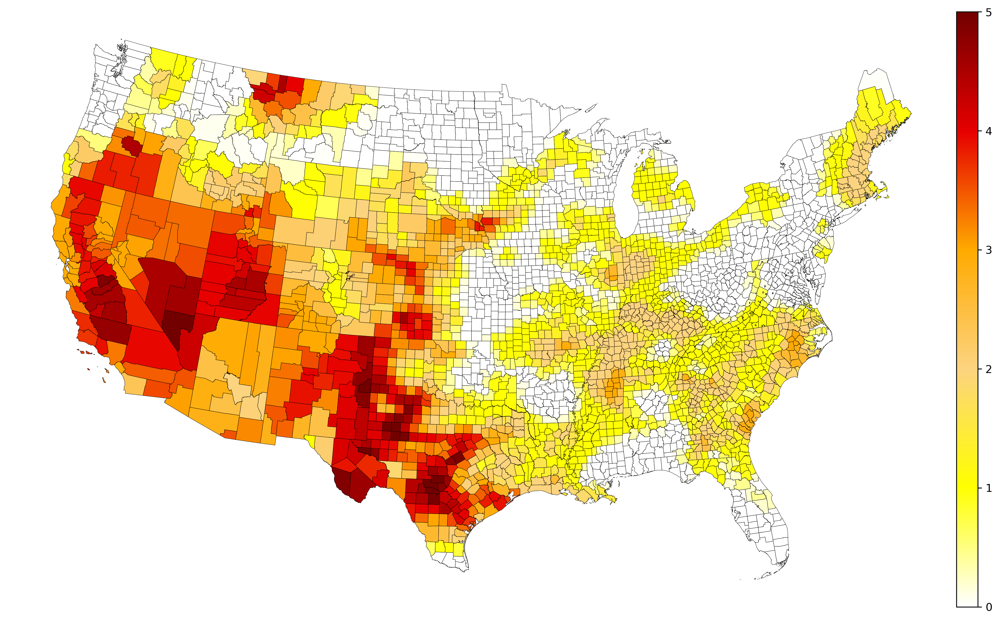

In [85]:
#To pretty up the colorbar:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig1, ax1 = plt.subplots(1,1, figsize=(16, 10), dpi=300)

#Pretty colorbar
divider = make_axes_locatable(ax1)
cax1 = divider.append_axes("right", size="2.25%", pad=0.025)

drought_level_gdf.plot(ax=ax1, edgecolor='black', linewidth=.25, column='DM_avg', cmap=drought_linear_cmap, alpha=1,
                 legend=True, cax=cax1);

ax1.set_axis_off()

#### Plot everything together:

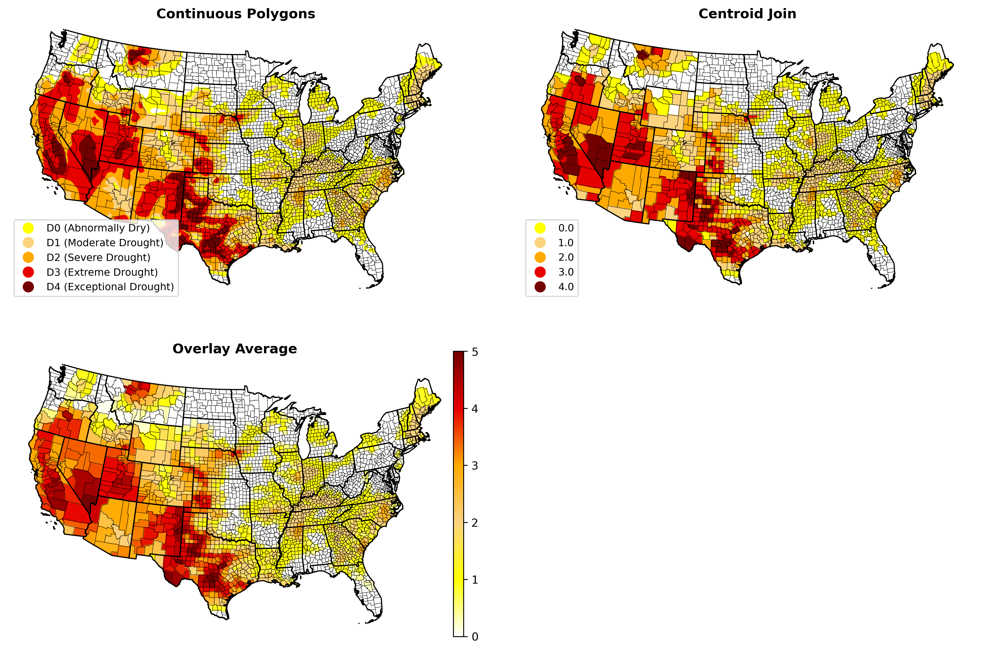

In [112]:
#To pretty up the colorbar:
from mpl_toolkits.axes_grid1 import make_axes_locatable


#Now see what we got:
########

#And the plot:
####

fig1, ax1 = plt.subplots(2,2, figsize=(16, 10), dpi=300)

ax1=ax1.flatten()


#First: Compare to continuous:
#######
drought_gdf.plot(ax=ax1[0], edgecolor='face', column='DM_String', cmap=drought_cmap,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.0,0.0), 'fontsize':9})


##Second: Compare to the simpler join from above:
#######
drought_discrete_gdf = join_gdf1

join_gdf1 = join_gdf1.set_geometry('geometry')
county_gdf = county_gdf.set_geometry('geometry')

####
join_gdf1.plot(ax=ax1[1], edgecolor='face', column='DM', cmap=drought_cmap, alpha=1,
                 categorical=True, legend=True, legend_kwds={'loc': 'lower left', 'bbox_to_anchor':(0.0,0.0), 'fontsize':9})



#And final the more comlicated overlay stuff:
#Our results:
##########

#Pretty colorbar
divider = make_axes_locatable(ax1[2])
cax1 = divider.append_axes("right", size="2.25%", pad=-.1)

drought_level_gdf.plot(ax=ax1[2], edgecolor='face', column='DM_avg', cmap=drought_linear_cmap, alpha=1,
                 legend=True, cax=cax1)


#### Some aesthetics

title_list = ['Continuous Polygons', 'Centroid Join', 'Overlay Average']

for i in range(3):
    #County outlines
    county_gdf.plot(ax=ax1[i], edgecolor='black', linewidth=.25, facecolor='none')

    #State outlines:
    state_gdf.plot(ax=ax1[i], edgecolor='black', linewidth=1, facecolor='none')

    #Title
    ax1[i].set_title(title_list[i], y=.97, fontweight='bold')
    
    ax1[i].set_axis_off()
    
    
plt.subplots_adjust(wspace=0.05, hspace=.175)

ax1[3].set_axis_off()

## Points in Polygons

- Could ask: Is Phoenix in a drought (locally speaking)?

- Can use same overlay or sjoins as above, but can also use the convenient `within` and `contains`!

In [87]:
## Let's check for drought in a binary sense: ANY Drought?
## Use a dissolve operation:

any_drought_gdf = drought_gdf.dissolve()

<AxesSubplot: >

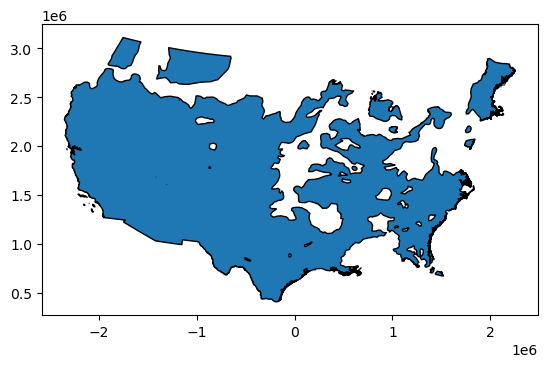

In [92]:
any_drought_gdf.plot(edgecolor='black')

In [101]:
###Let's actually check for several western cities:

df = pd.DataFrame(
    {'Name': ['Phoenix', 'Los Angeles', 'Denver', 'SLC'],
     'Latitude': [33.4484, 34.0522, 39.7392, 40.7608],
     'Longitude': [-112.0740, -118.2437, -104.9903, -111.8910]})

city_gdf = gpd.GeoDataFrame(df, geometry = gpd.points_from_xy(df.Longitude, df.Latitude), crs = "EPSG:4326")
city_gdf = city_gdf.to_crs(5070)

#Let's use within!
#######
city_gdf.within(any_drought_gdf.geometry[0])

0    True
1    True
2    True
3    True
dtype: bool

In [102]:
#Could also use overlap...
#Here use drought_gdf vs. any_drought_gdf to get actual level of drought:
city_overlap = gpd.overlay(city_gdf, drought_gdf, how="intersection")

city_overlap

,Name,Latitude,Longitude,OBJECTID,DM,Shape_Leng,Shape_Area,DM_String,geometry
0,Phoenix,33.4484,-112.0740,3,2,4.895095e+07,1.196336e+12,D2 (Severe Drought),POINT (-1477243.001 1278582.656)
1,Los Angeles,34.0522,-118.2437,3,2,4.895095e+07,1.196336e+12,D2 (Severe Drought),POINT (-2019685.019 1458261.984)
2,Denver,39.7392,-104.9903,2,1,6.957710e+07,1.559804e+12,D1 (Moderate Drought),POINT (-762409.034 1893843.465)
3,SLC,40.7608,-111.8910,4,3,3.197661e+07,1.073981e+12,D3 (Extreme Drought),POINT (-1324295.270 2083183.761)


In [103]:
#Could also use contains:
####

[any_drought_gdf.contains(city_gdf.geometry[i]) for i in range(4)]

[0    True
 dtype: bool,
 0    True
 dtype: bool,
 0    True
 dtype: bool,
 0    True
 dtype: bool]

In [111]:
## contains is better if we have multiple polygons and 1 point
# Try on our original drought_gdf:

#Can see that LA is in the level 2 drought category
#And can see that SLC is in level 3 drought category
drought_gdf.contains(city_gdf.geometry[3])

0    False
1    False
2    False
3     True
4    False
dtype: bool

### 100th Meridian

- Tag counties as either west or east of the 100th Meridian, based on county centroids

- Compare drought status

- How many people are exposed to drought in west vs. east?


Let's use `drought_discrete_gdf` for a simpler approximation...

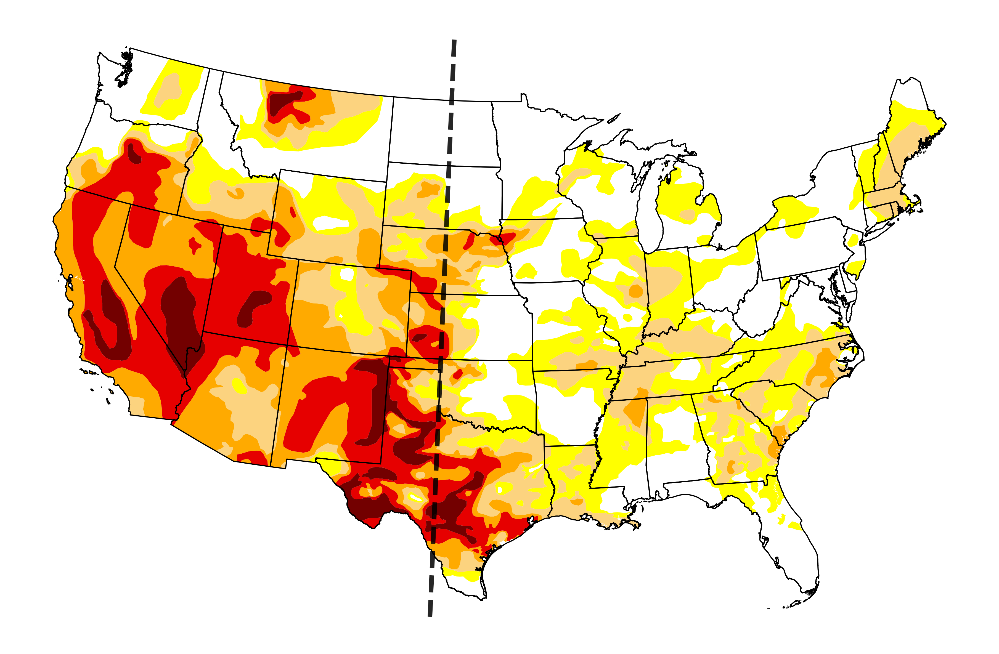

In [116]:
#First note:
#We can add a line that represents the 100th meridian:

from shapely.geometry import Point, LineString

point1 = Point(-100, 25)
point2 = Point(-100, 52)

#Can do as:
line = LineString([point1, point2])

#Or:
line_from_tuples = LineString([(-100, 25), (-100, 52)])
line_from_tuples

#Embed in GeoDataFrame
line_gdf = gpd.GeoDataFrame(index=[0], geometry=[line], crs=4326)
line_gdf = line_gdf.to_crs(5070)


#Plot along with drought:
fig1, ax1 = plt.subplots(1,1, figsize=(16, 10), dpi=300)

drought_gdf.plot(ax=ax1, cmap=drought_cmap)
state_gdf.plot(ax=ax1, facecolor='none', edgecolor='black')
line_gdf.plot(ax=ax1, color='black', linewidth=4, linestyle='--', alpha=.85)

ax1.set_axis_off()


In [113]:
#County is west or east?
#Just base on centroid
#Need geographic CRS:

drought_discrete_gdf = drought_discrete_gdf.to_crs(4269)
drought_discrete_gdf['cent_4269'] = drought_discrete_gdf.centroid

####

drought_discrete_gdf['West'] = drought_discrete_gdf.cent_4269.x < -100

#### Back to CRS 5070:
drought_discrete_gdf = drought_discrete_gdf.to_crs(5070)

C:\Users\steff\AppData\Local\Temp\ipykernel_11940\1023164207.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  drought_discrete_gdf['cent_4269'] = drought_discrete_gdf.centroid


In [114]:
#Store the Lon/Lat explicitly, if we like
drought_discrete_gdf['Lon'] = drought_discrete_gdf.cent_4269.x
drought_discrete_gdf['Lat'] = drought_discrete_gdf.cent_4269.y

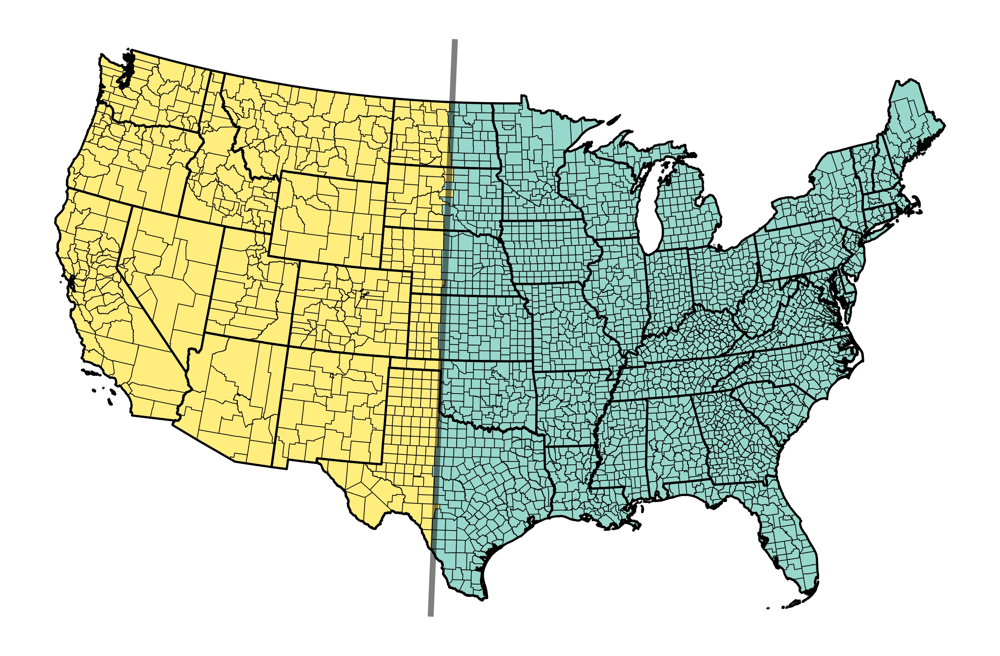

In [121]:
#Plot again:
############

drought_discrete_gdf = drought_discrete_gdf.set_geometry('geometry')

fig, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=300)
drought_discrete_gdf.plot(ax = ax1, linewidth = .5, edgecolor = 'black', column = 'West', cmap='Set3', alpha=.9)
state_gdf.plot(ax = ax1, linewidth = 1.5, edgecolor = 'black', facecolor = 'none')

line_gdf.plot(ax=ax1, color='black', linewidth=4, linestyle='-', alpha=.5)

ax1.set_axis_off()

### How many people were exposed to drought of various levels?

- Merge in population

- Do a simple `groupby()`

In [122]:
#Grab the Census demographic data again
url_name = r'https://www2.census.gov/programs-surveys/popest/datasets/2010-2020/counties/totals/co-est2020-alldata.csv'

#Note the encoding:
df = pd.read_csv(url_name, encoding = "ISO-8859-1", engine='python')

df['FIPS'] = df.STATE.astype(str).str.zfill(2) + df.COUNTY.astype(str).str.zfill(3)

In [123]:
#Merge the population data
drought_discrete_gdf = drought_discrete_gdf.merge(df[['POPESTIMATE2020', 'FIPS']], on='FIPS', how='left')

In [128]:
#Population in West vs. East?

#Let's fill NaNs with -1, for no drought:
#And a groupby/sum:
drought_discrete_gdf.fillna(-1).groupby(['West']).sum()['POPESTIMATE2020'] / 1e6

West
False    247.345945
True      80.000014
Name: POPESTIMATE2020, dtype: float64

In [130]:
#Approximate land area West vs. East?

#And a groupby/sum:
drought_discrete_gdf.fillna(-1).groupby(['West']).sum()['ALAND'] / 1e9

West
False    3970.943512
True     3684.013708
Name: ALAND, dtype: float64

In [131]:
#And drought levels, West vs. East?

#And a groupby/sum:
drought_discrete_gdf.fillna(-1).groupby(['West', 'DM']).sum()['POPESTIMATE2020'] / 1e6

West   DM  
False  -1.0    115.116684
        0.0     69.904064
        1.0     46.694187
        2.0      9.767052
        3.0      5.410348
        4.0      0.453610
True   -1.0     11.540846
        0.0      3.606897
        1.0     10.455458
        2.0     34.600722
        3.0     14.481454
        4.0      5.314637
Name: POPESTIMATE2020, dtype: float64

<AxesSubplot: xlabel='West,DM'>

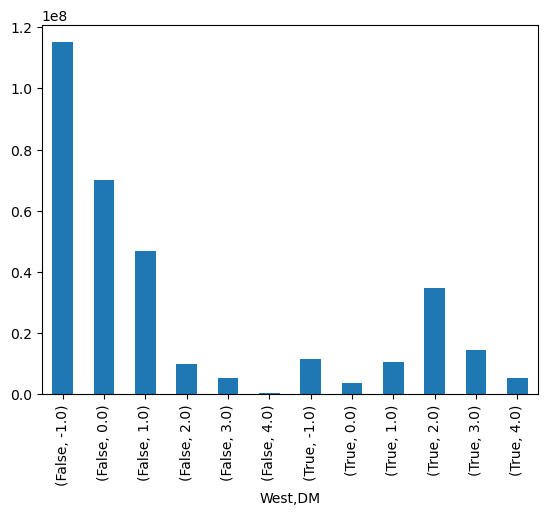

In [132]:
#Quick bar plot:
drought_discrete_gdf.fillna(-1).groupby(['West', 'DM']).sum()['POPESTIMATE2020'].plot.bar()

In [134]:
#Just overall population exposure to different drought levels?
####

drought_discrete_gdf.fillna(-1).groupby(['DM']).sum()['POPESTIMATE2020'] / 1e6


DM
-1.0    126.657530
 0.0     73.510961
 1.0     57.149645
 2.0     44.367774
 3.0     19.891802
 4.0      5.768247
Name: POPESTIMATE2020, dtype: float64